In [1]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, GlobalAveragePooling2D

In [2]:
# Data directories
train_dir = R'C:\Users\jroqu\OneDrive\Desktop\CPE313\Final Project\Ant Species Classification.v1i.multiclass\train4'
valid_dir = R'C:\Users\jroqu\OneDrive\Desktop\CPE313\Final Project\Ant Species Classification.v1i.multiclass\valid4'
test_dir = R'C:\Users\jroqu\OneDrive\Desktop\CPE313\Final Project\Ant Species Classification.v1i.multiclass\test4'

In [3]:
# Image dimensions and batch size
img_width, img_height = 150, 150
batch_size = 32

In [4]:
# Data preprocessing and augmentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical')

validation_generator = test_datagen.flow_from_directory(
    valid_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical')

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False)

Found 3165 images belonging to 4 classes.
Found 302 images belonging to 4 classes.
Found 150 images belonging to 4 classes.


In [5]:
# Define MobileNetV2 model
def create_mobilenet_model(input_shape, num_classes):
    base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=input_shape)
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, activation='relu')(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    
    for layer in base_model.layers:
        layer.trainable = False

    return model

In [6]:
# Function to compile and train model
def compile_and_train(model, train_generator, validation_generator, epochs=50):
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    history = model.fit(
        train_generator,
        steps_per_epoch=train_generator.samples // batch_size,
        epochs=epochs,
        validation_data=validation_generator,
        validation_steps=validation_generator.samples // batch_size)
    return history

In [7]:
# Evaluate and plot results for a model
def evaluate_and_plot(model, history, test_generator, model_name):
    # Evaluate the model on the test set
    test_loss, test_accuracy = model.evaluate(test_generator)
    print(f"{model_name} Test Loss: {test_loss:.4f}")
    print(f"{model_name} Test Accuracy: {test_accuracy:.4f}")

    # Confusion matrix
    test_predictions = model.predict(test_generator)
    true_labels = test_generator.classes
    predicted_labels = np.argmax(test_predictions, axis=1)
    cm = confusion_matrix(true_labels, predicted_labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title(f'{model_name} Confusion Matrix')
    plt.show()

    # Normalized confusion matrix
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm_normalized, annot=True, cmap='Blues', fmt='.2f', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title(f'{model_name} Normalized Confusion Matrix')
    plt.show()

    # Classification report
    class_labels = list(test_generator.class_indices.keys())
    print(f"{model_name} Classification Report:")
    print(classification_report(true_labels, predicted_labels, target_names=class_labels))

    # Plot accuracy and loss
    def plot_accuracy(history):
        plt.plot(history.history['accuracy'], label='accuracy')
        plt.plot(history.history['val_accuracy'], label='val_accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.ylim([0, 1])
        plt.title(f'{model_name} Training and Validation Accuracy per Epoch')
        plt.legend(loc='lower right')
        plt.show()

    def plot_loss(history):
        plt.plot(history.history['loss'], label='loss')
        plt.plot(history.history['val_loss'], label='val_loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.ylim([0, max(max(history.history['loss']), max(history.history['val_loss']))])
        plt.legend(loc='upper right')
        plt.title(f'{model_name} Training and Validation Loss per Epoch')
        plt.show()

    plot_accuracy(history)
    plot_loss(history)

In [8]:
# Input shape and number of classes
input_shape = (img_width, img_height, 3)
num_classes = len(train_generator.class_indices)

C:\Users\jroqu\AppData\Local\Temp\ipykernel_20364\2461995487.py:3: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=input_shape)


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 150, 150,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 75, 75,    │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 75, 75,    │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 75, 75,    │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 75, 75,    │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 75, 75,    │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 75, 75,    │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 75, 75,    │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 75, 75,    │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 75, 75,    │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 75, 75,    │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 75, 75,    │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 77, 77,    │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 38, 38,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 38, 38,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 38, 38,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 38, 38,    │      2,304 │ block_1_depthwis

 Total params: 2,422,468 (9.24 MB)

 Trainable params: 164,484 (642.52 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

Epoch 1/50


C:\Users\jroqu\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


98/98 ━━━━━━━━━━━━━━━━━━━━ 17s 149ms/step - accuracy: 0.6518 - loss: 0.8544 - val_accuracy: 0.8160 - val_loss: 0.4710
Epoch 2/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8438 - loss: 0.3338 - val_accuracy: 0.8571 - val_loss: 0.4234
Epoch 3/50


C:\Program Files\WindowsApps\PythonSoftwareFoundation.Python.3.11_3.11.2544.0_x64__qbz5n2kfra8p0\Lib\contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


98/98 ━━━━━━━━━━━━━━━━━━━━ 15s 141ms/step - accuracy: 0.8767 - loss: 0.3312 - val_accuracy: 0.8611 - val_loss: 0.3583
Epoch 4/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 639us/step - accuracy: 0.8750 - loss: 0.2542 - val_accuracy: 0.8571 - val_loss: 0.2771
Epoch 5/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 14s 136ms/step - accuracy: 0.9181 - loss: 0.2304 - val_accuracy: 0.8854 - val_loss: 0.3158
Epoch 6/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 565us/step - accuracy: 0.9688 - loss: 0.2309 - val_accuracy: 0.9286 - val_loss: 0.2453
Epoch 7/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 14s 136ms/step - accuracy: 0.9259 - loss: 0.2170 - val_accuracy: 0.8993 - val_loss: 0.3183
Epoch 8/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 566us/step - accuracy: 0.9062 - loss: 0.1926 - val_accuracy: 0.8571 - val_loss: 0.3932
Epoch 9/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.9315 - loss: 0.1991 - val_accuracy: 0.9236 - val_loss: 0.2543
Epoch 10/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 538us/step - accuracy: 0.9688 - loss: 0.1032 - val_accuracy: 1.0000 -

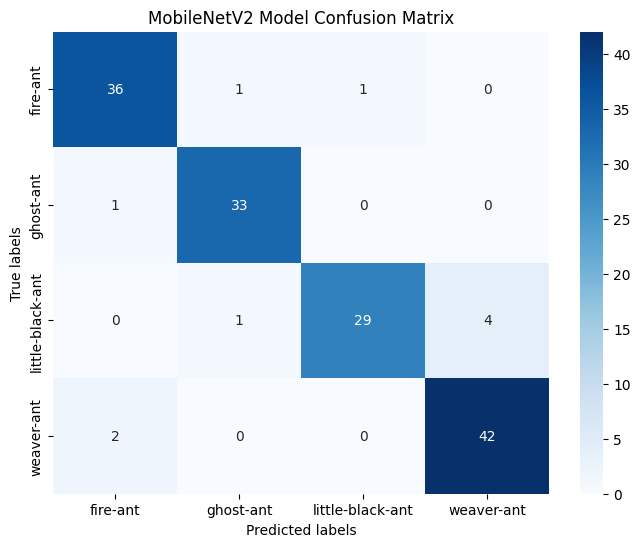

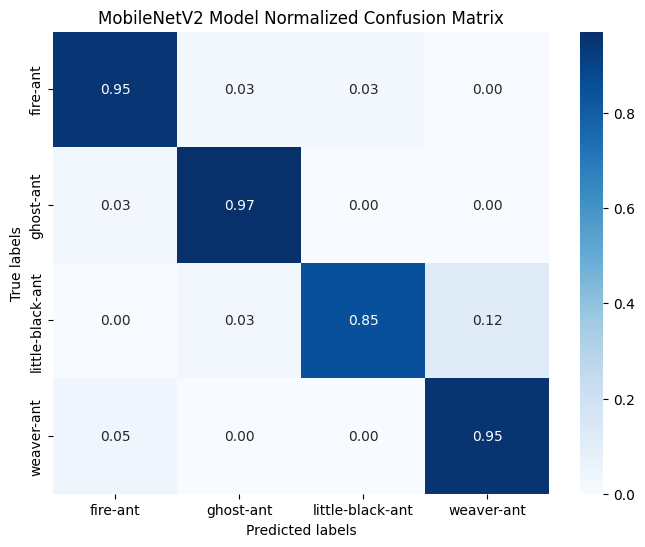

MobileNetV2 Model Classification Report:
                  precision    recall  f1-score   support

        fire-ant       0.92      0.95      0.94        38
       ghost-ant       0.94      0.97      0.96        34
little-black-ant       0.97      0.85      0.91        34
      weaver-ant       0.91      0.95      0.93        44

        accuracy                           0.93       150
       macro avg       0.94      0.93      0.93       150
    weighted avg       0.93      0.93      0.93       150



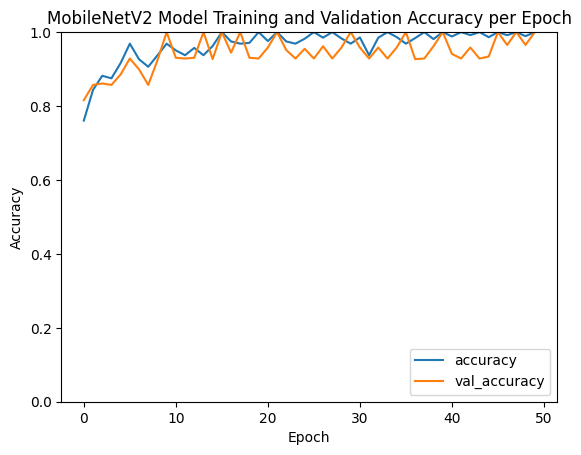

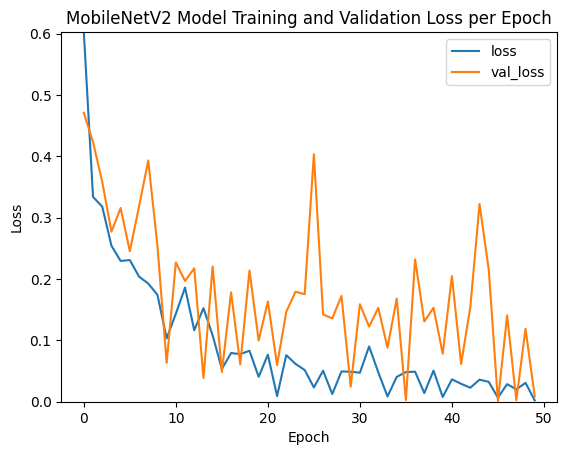

In [9]:
# Train and evaluate MobileNetV2 model
mobilenet_model = create_mobilenet_model(input_shape, num_classes)
mobilenet_model.summary()
mobilenet_history = compile_and_train(mobilenet_model, train_generator, validation_generator)
evaluate_and_plot(mobilenet_model, mobilenet_history, test_generator, "MobileNetV2 Model")

In [10]:
# Define recommendations
recommendations = {
    0: "Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.",
    1: "Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.",
    2: "Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.",
    3: "Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants."
}

C:\Users\jroqu\AppData\Local\Temp\ipykernel_20364\2461995487.py:3: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=input_shape)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


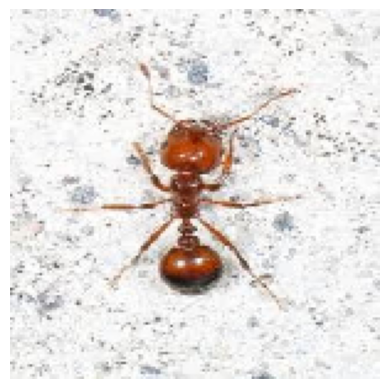

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.


In [11]:
from keras.preprocessing import image
# Load a single image for testing
img_path = R'C:\Users\jroqu\OneDrive\Desktop\CPE313\Final Project\Ant Species Classification.v1i.multiclass\test4\fire-ant\fire-ant-68-_jpg.rf.333ef8f3f29c89bf2eaee428189614dd.jpg'
img = image.load_img(img_path, target_size=(img_width, img_height))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)

# Classify the image
base_model = create_mobilenet_model(input_shape, num_classes)
single_prediction = base_model.predict(x)
single_predicted_class = np.argmax(single_prediction)

# Display the image
plt.imshow(img)
plt.axis('off')
plt.show()

# Print recommendation
print("Recommendation:", recommendations[single_predicted_class])

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


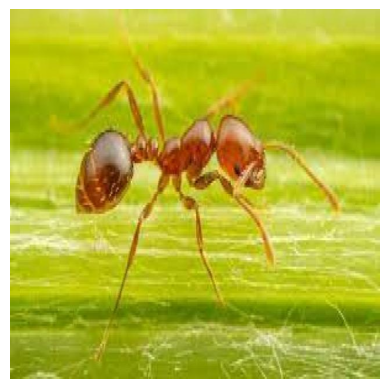

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



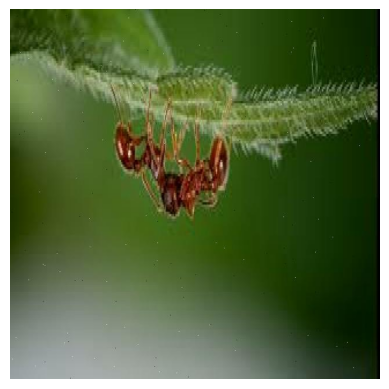

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



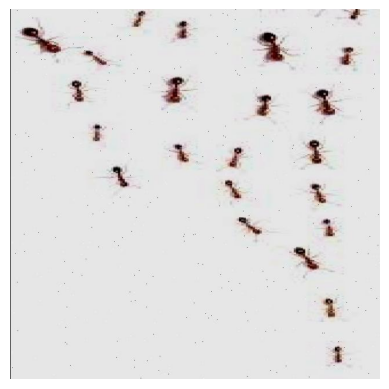

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



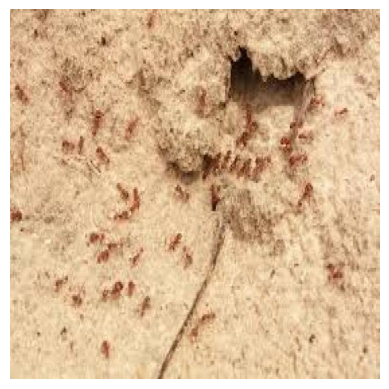

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



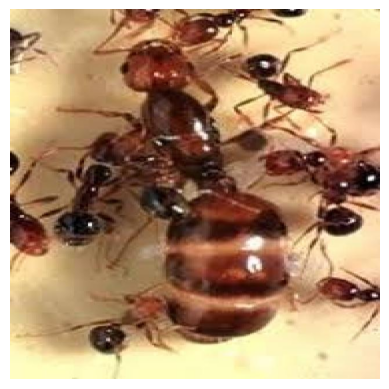

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



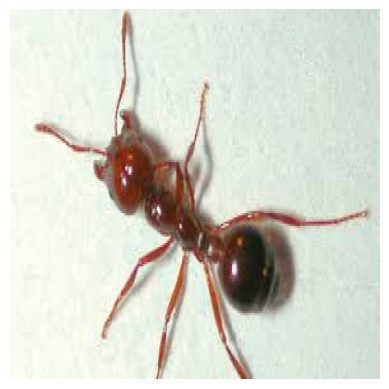

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



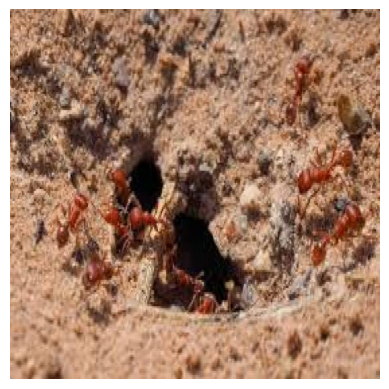

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



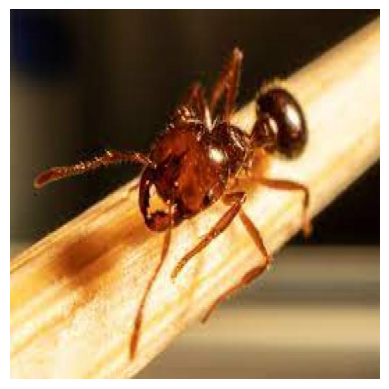

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



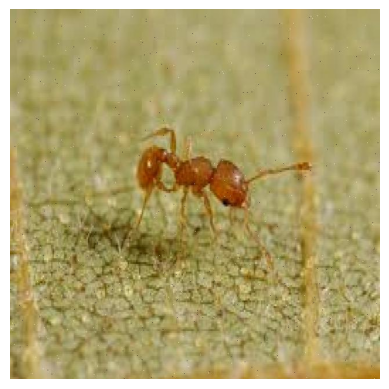

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



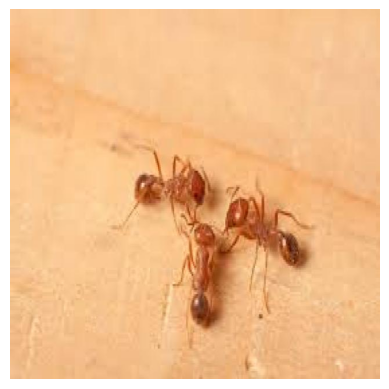

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



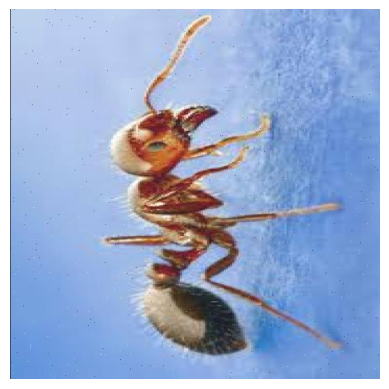

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



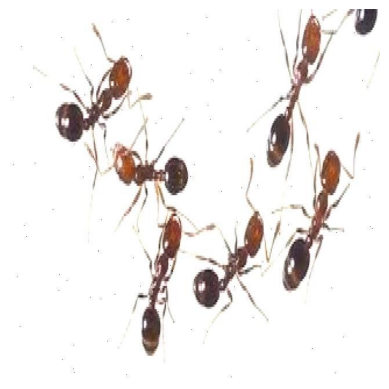

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



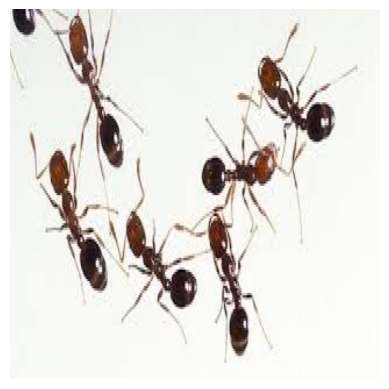

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



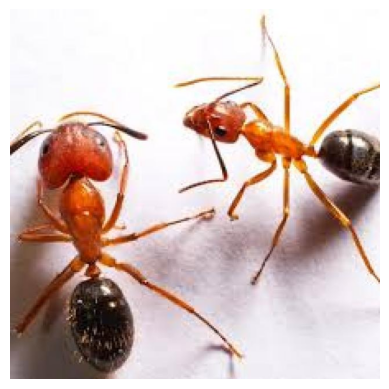

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



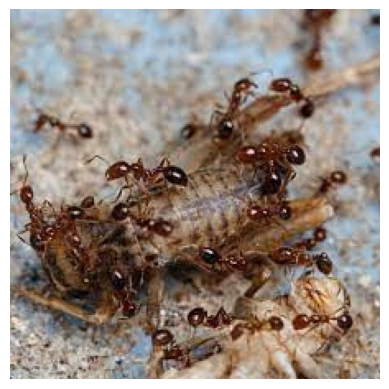

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



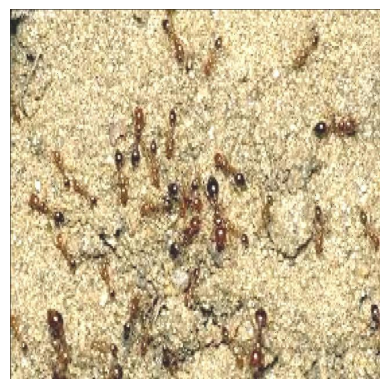

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



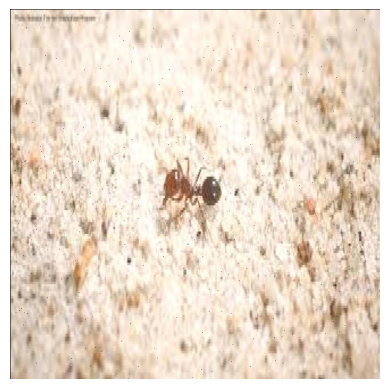

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



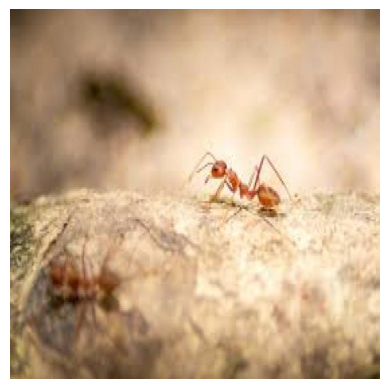

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



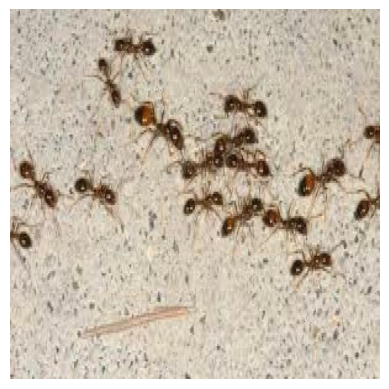

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



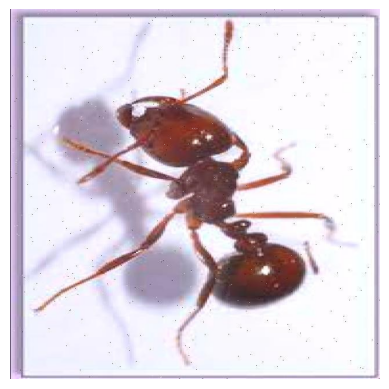

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



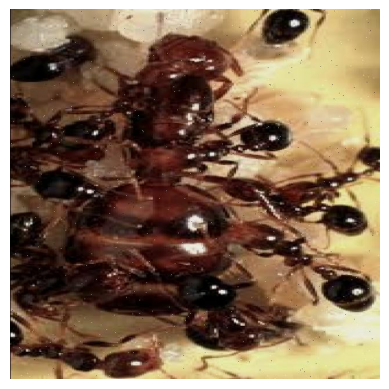

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



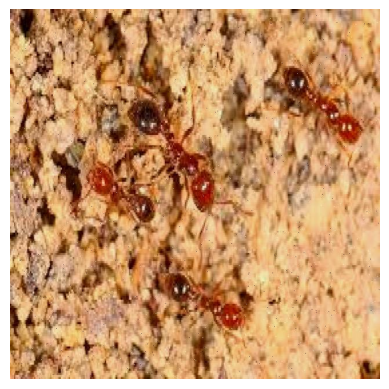

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



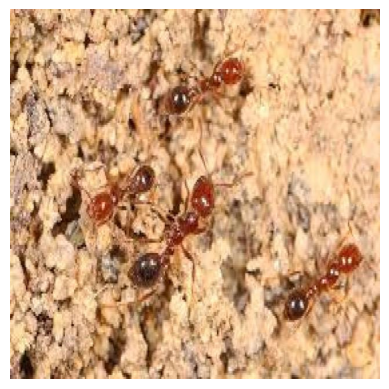

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



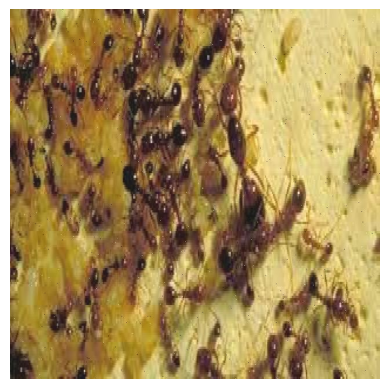

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



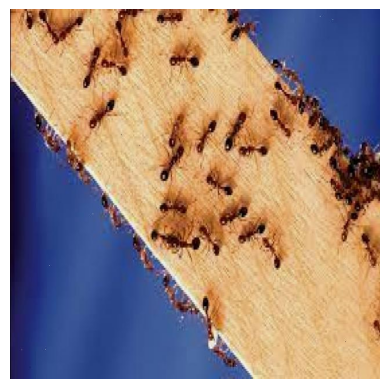

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



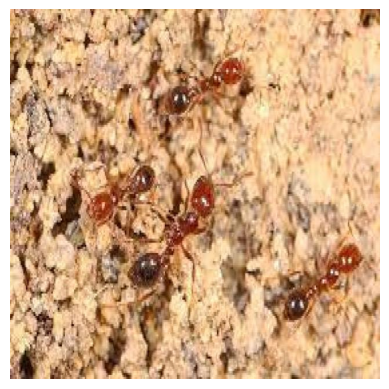

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



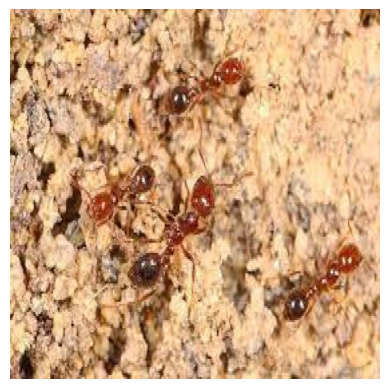

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



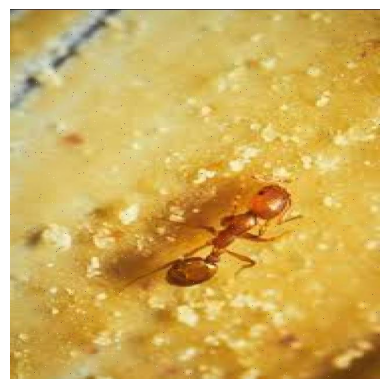

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



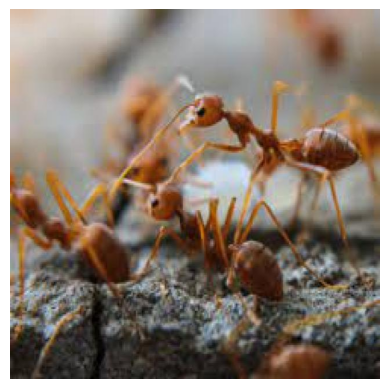

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



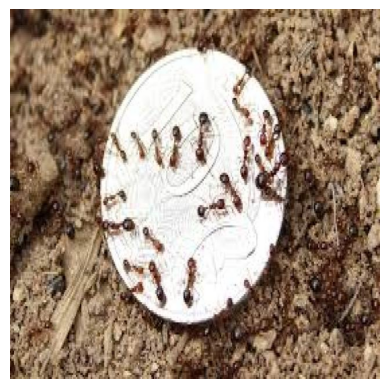

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



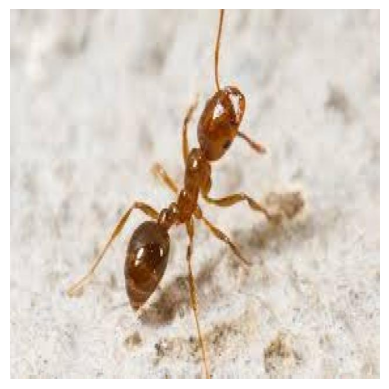

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



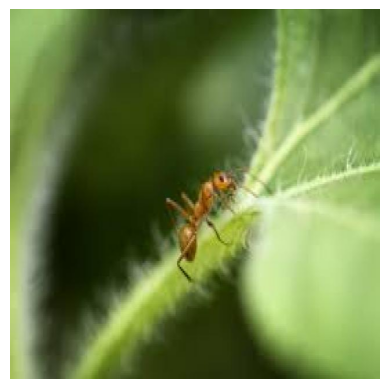

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



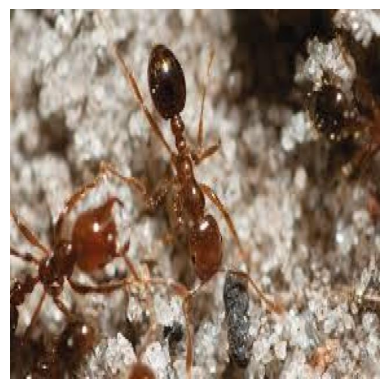

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



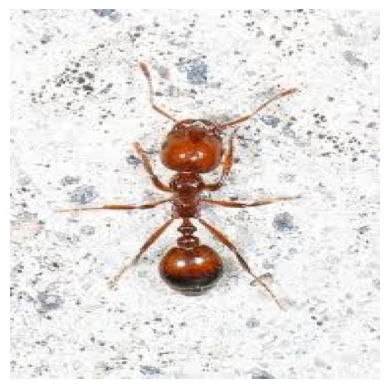

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



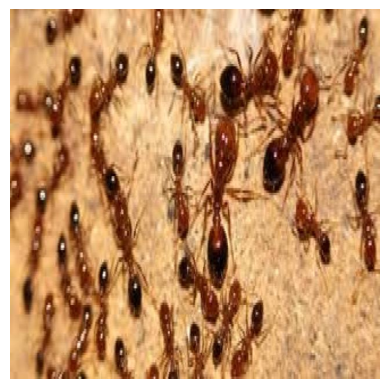

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



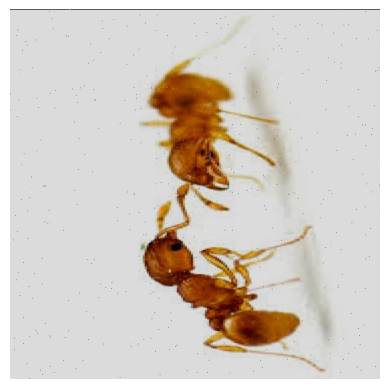

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



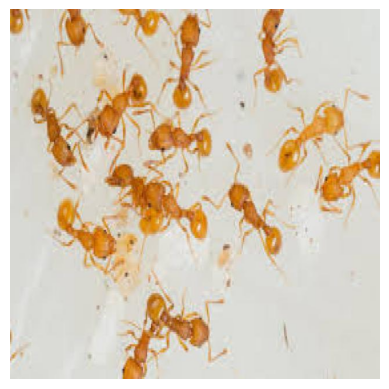

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



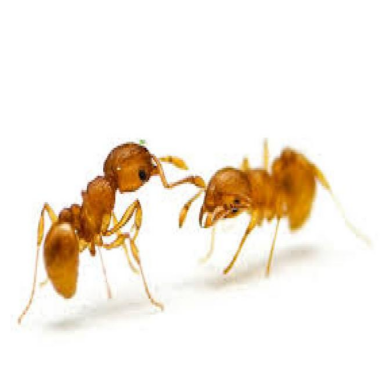

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



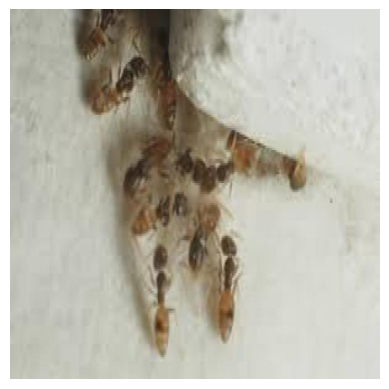

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



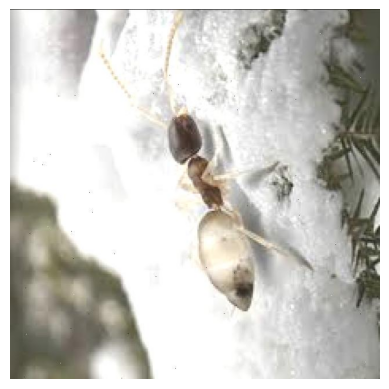

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



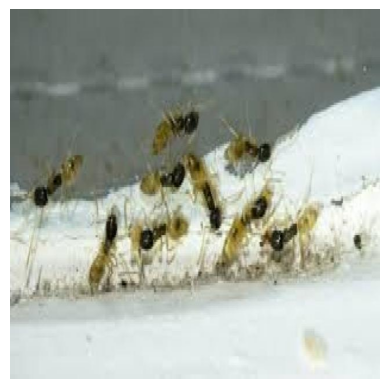

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



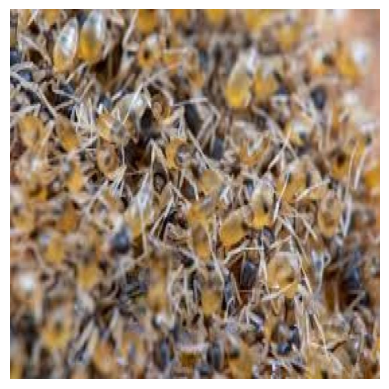

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



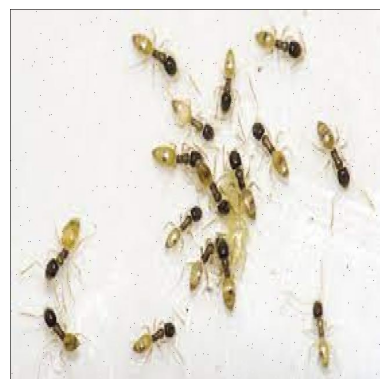

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



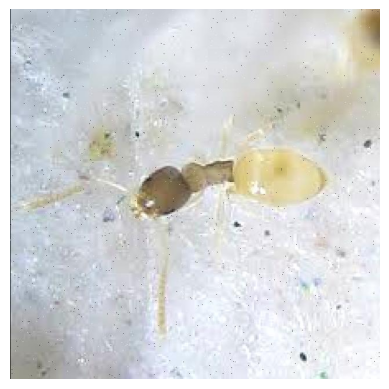

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



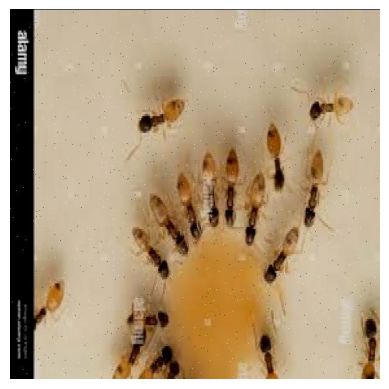

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



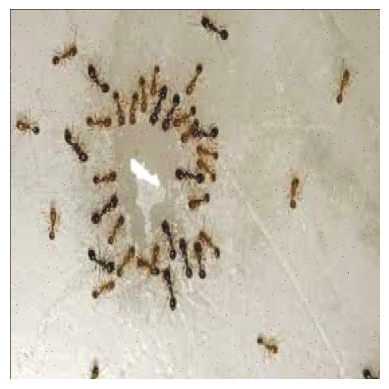

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



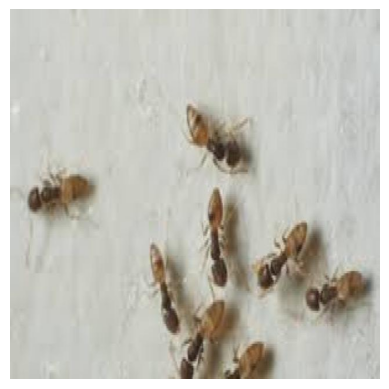

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



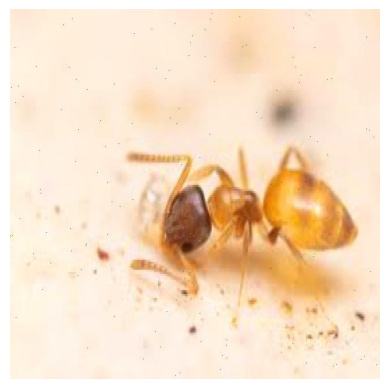

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



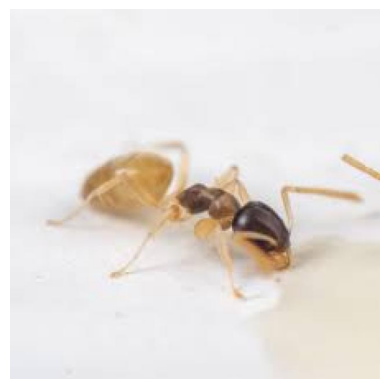

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



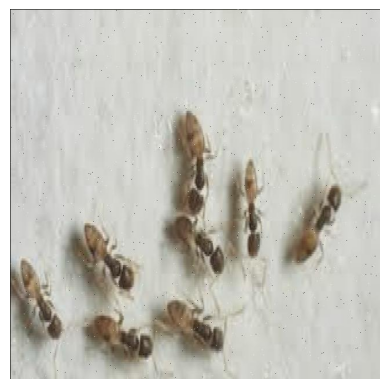

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



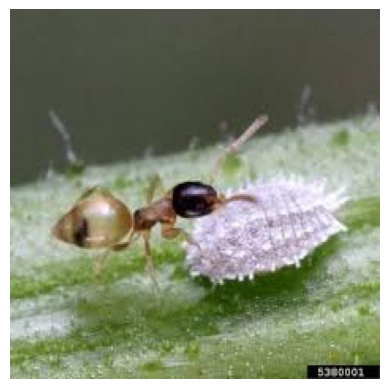

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



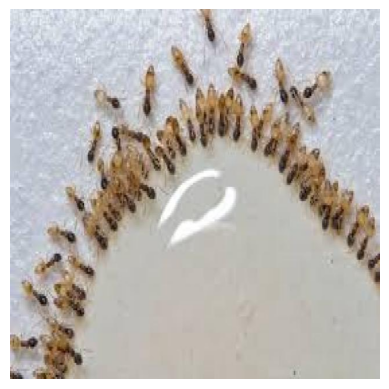

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



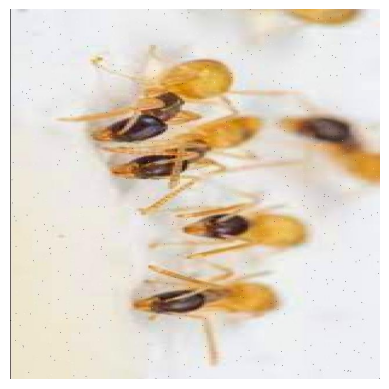

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



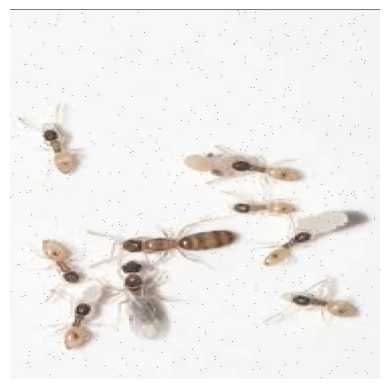

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



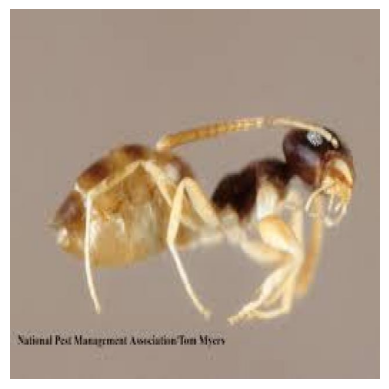

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



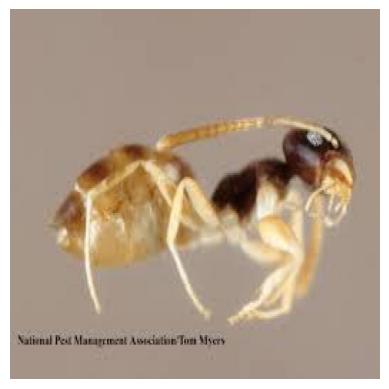

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



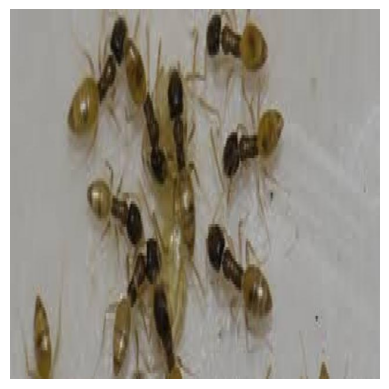

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



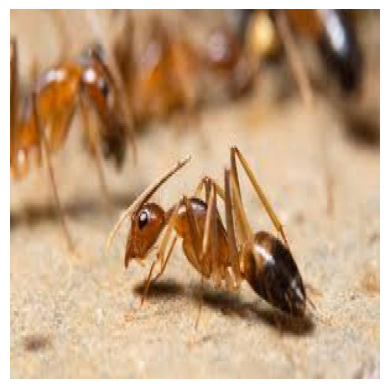

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



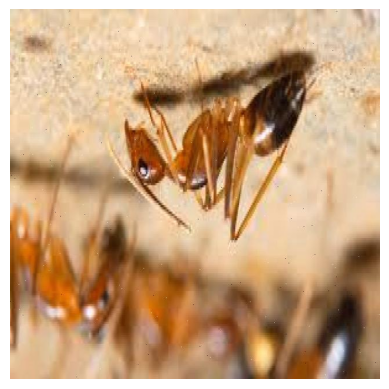

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



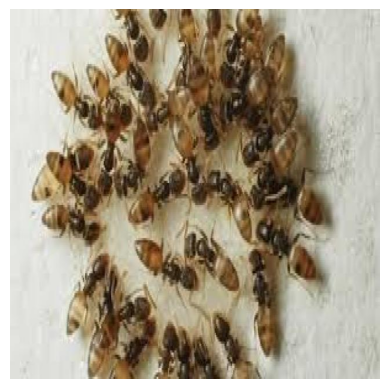

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



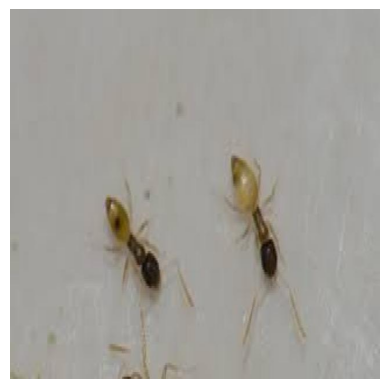

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



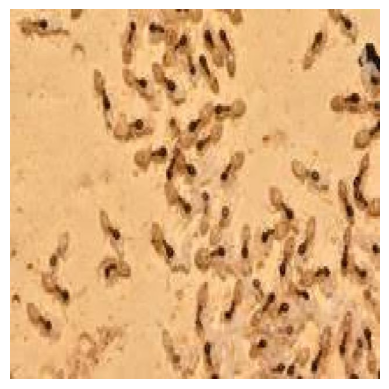

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



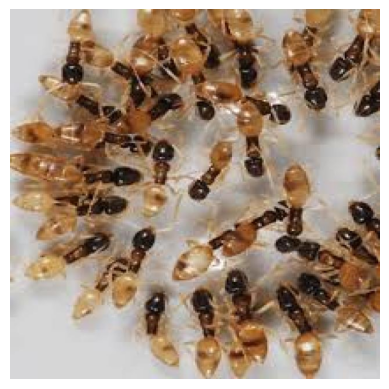

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



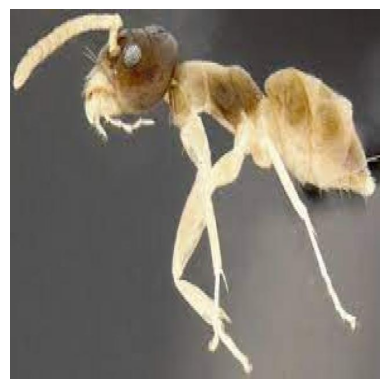

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



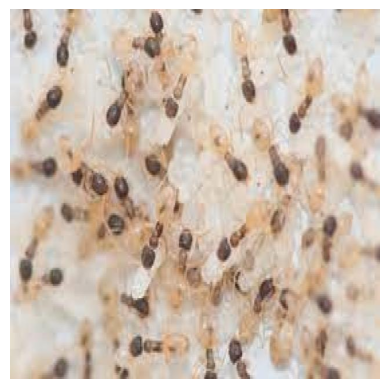

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



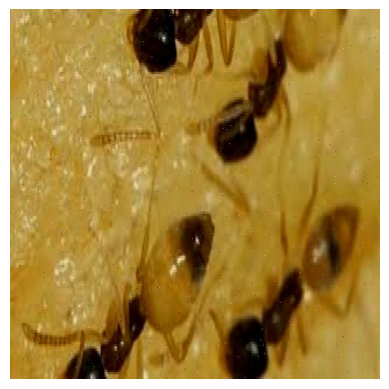

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



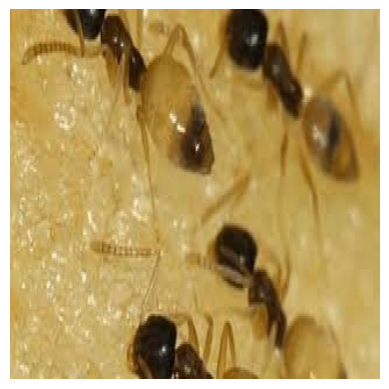

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



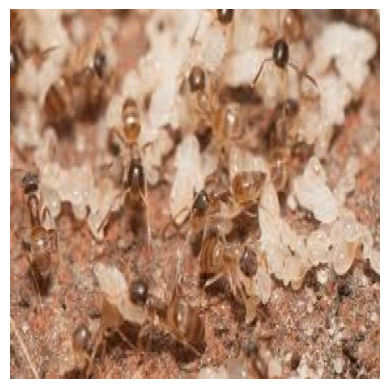

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



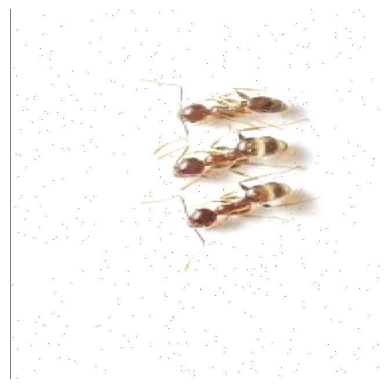

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



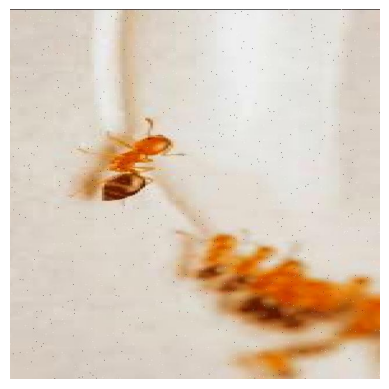

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



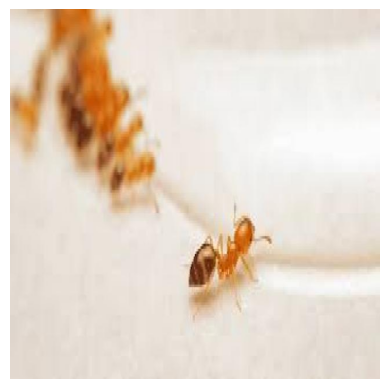

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



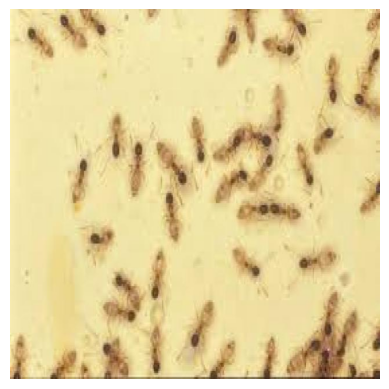

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



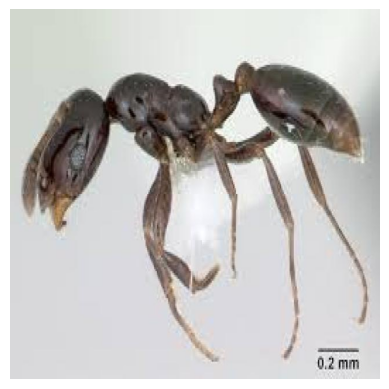

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



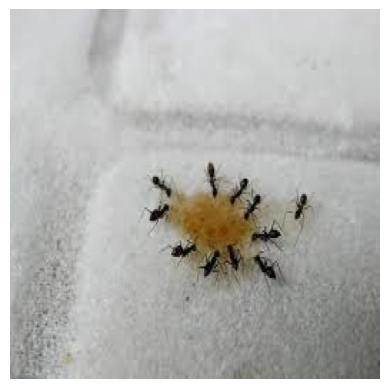

Recommendation: Ghost Ant: Often found indoors. Use baits containing boric acid to control ghost ants.



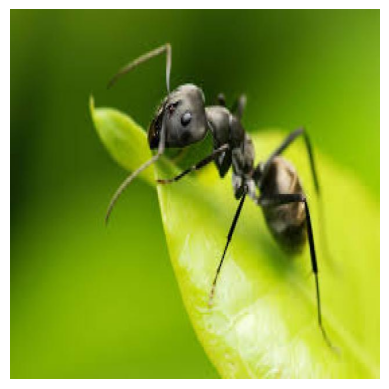

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



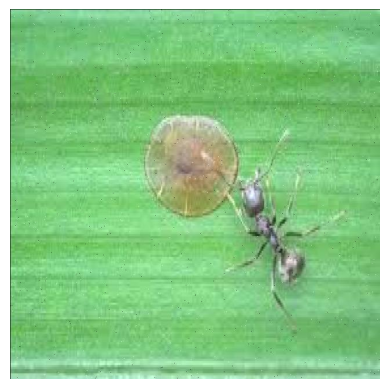

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



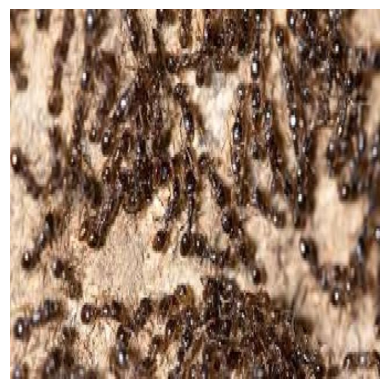

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



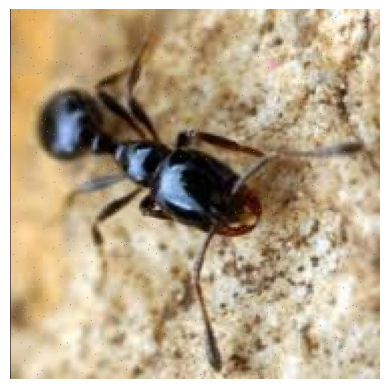

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



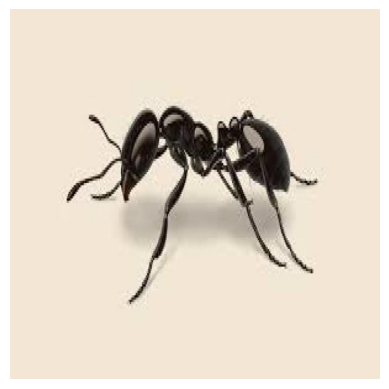

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



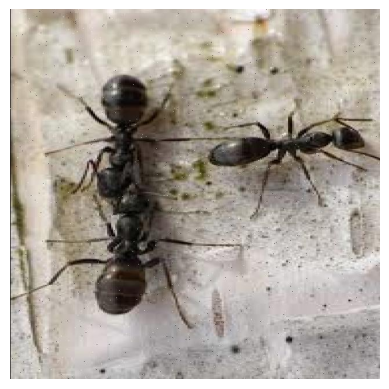

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



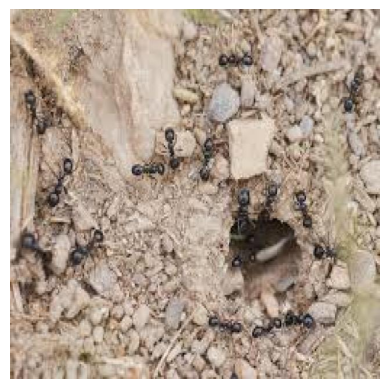

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



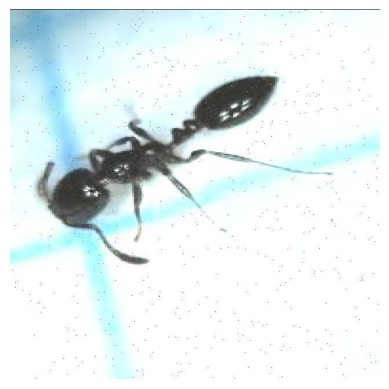

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



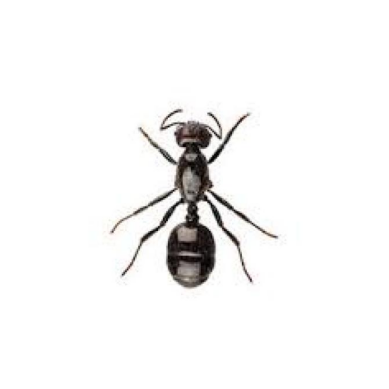

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



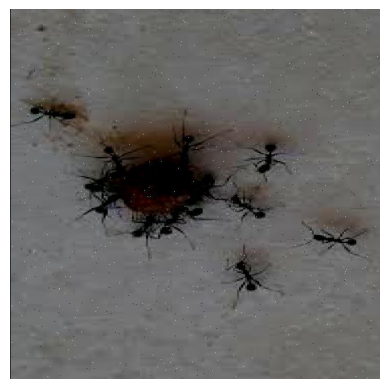

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



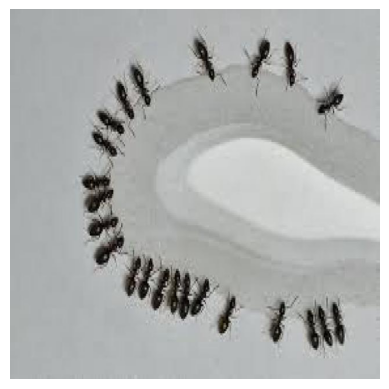

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



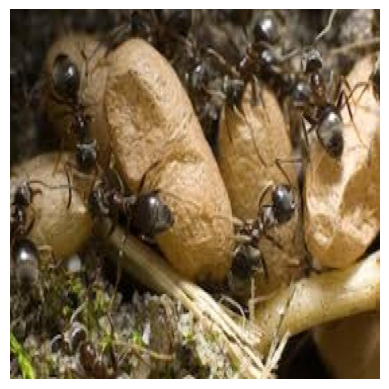

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



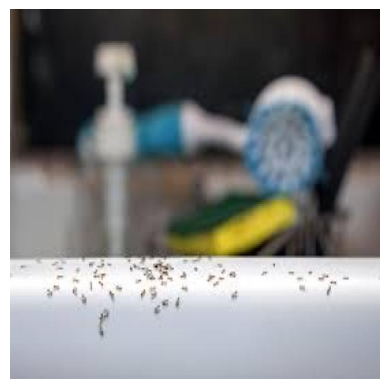

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



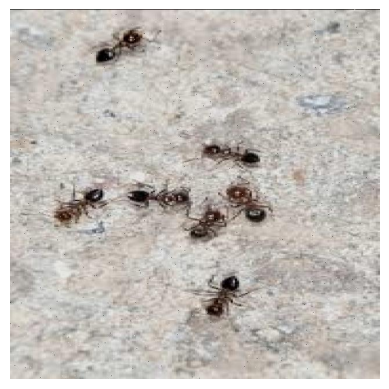

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



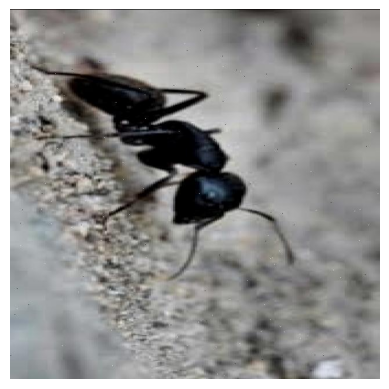

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



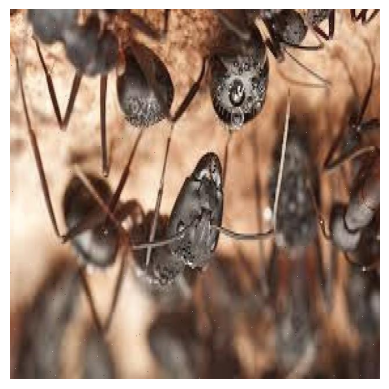

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



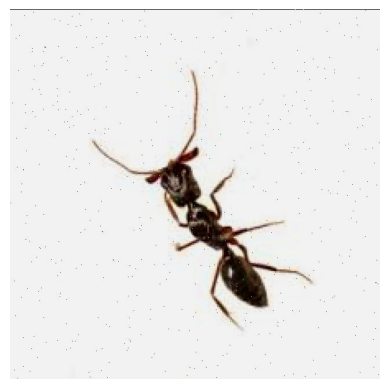

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



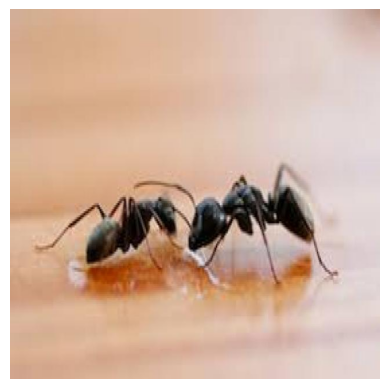

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



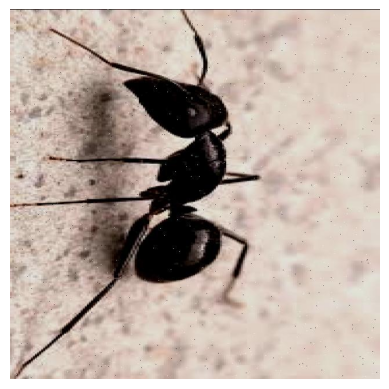

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



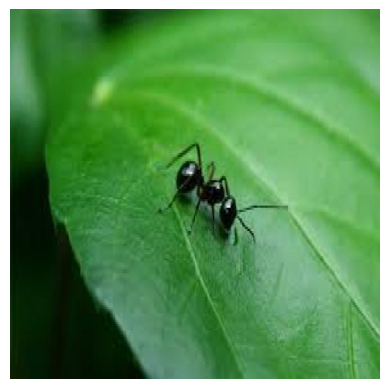

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



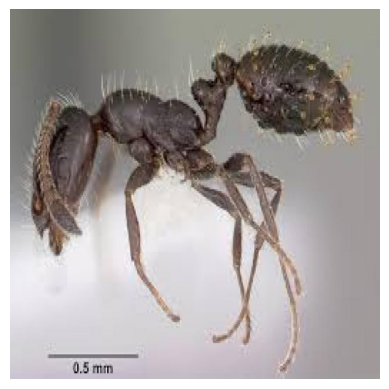

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



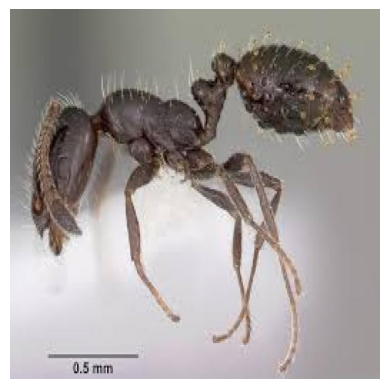

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



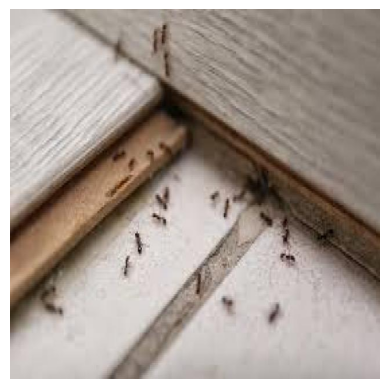

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



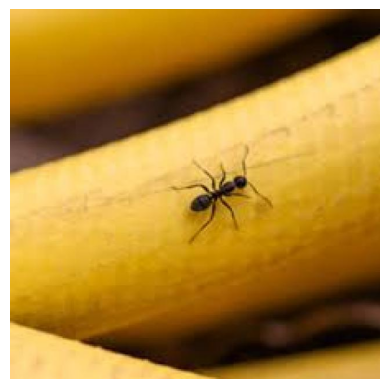

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



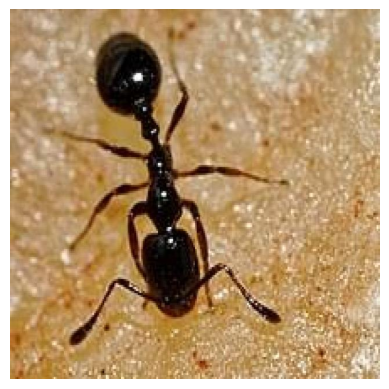

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



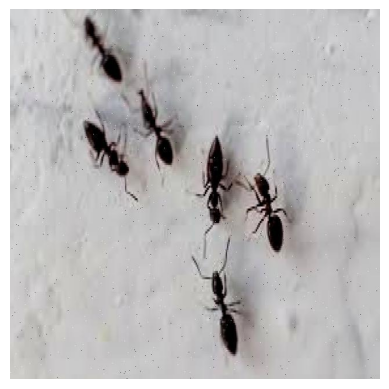

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



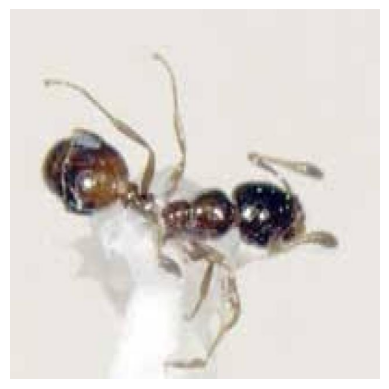

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



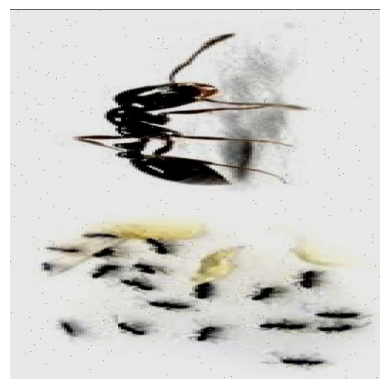

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



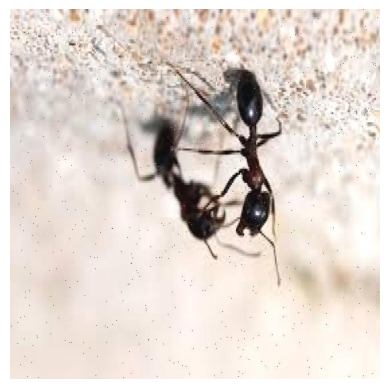

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



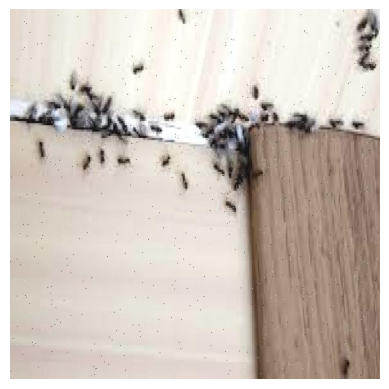

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



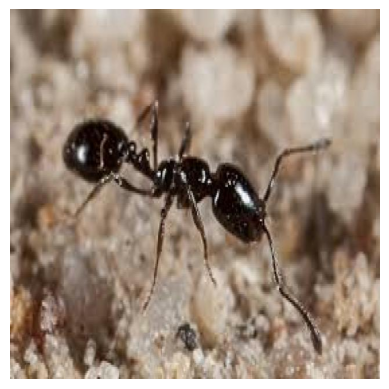

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



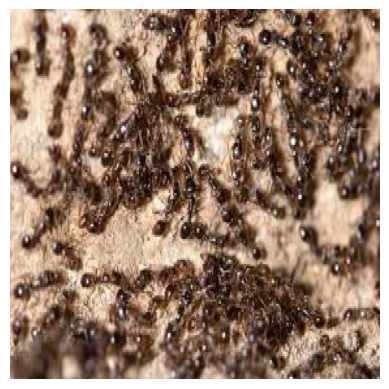

Recommendation: Little Black Ant: Generally harmless but can infest food. Seal entry points and use ant baits to manage little black ants.



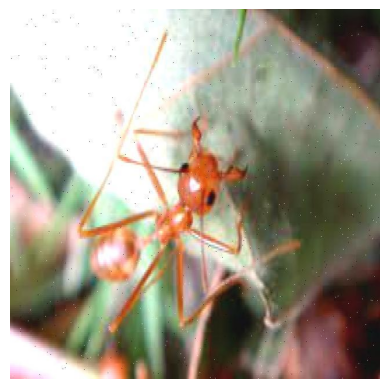

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



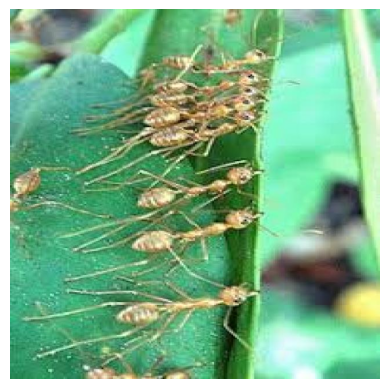

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



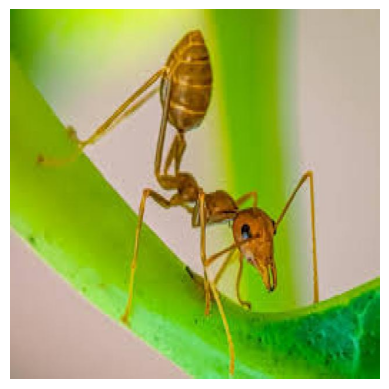

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



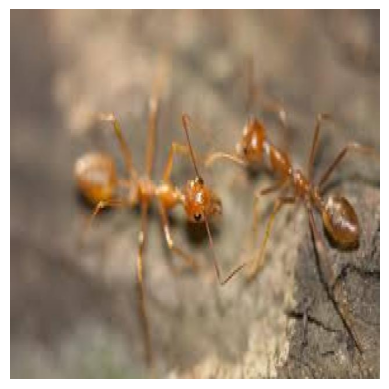

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



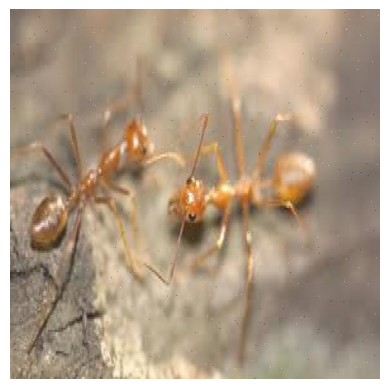

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



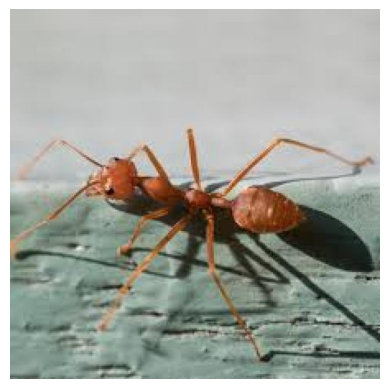

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



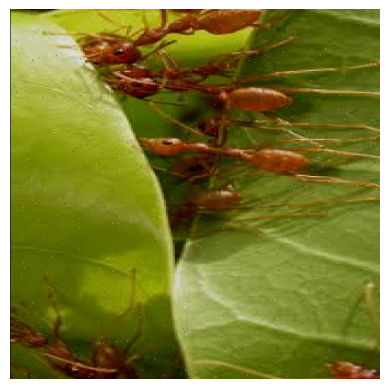

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



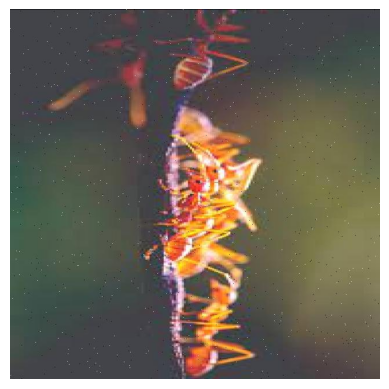

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



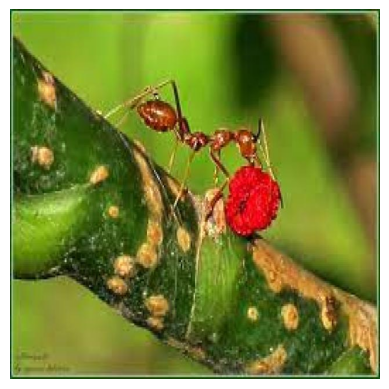

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



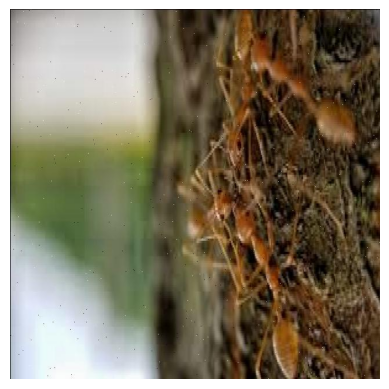

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



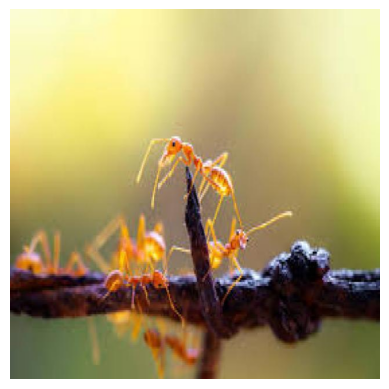

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



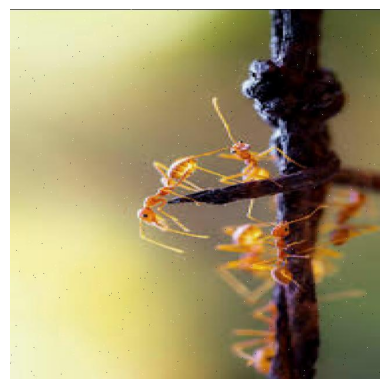

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



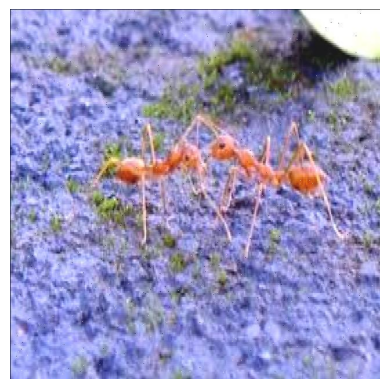

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



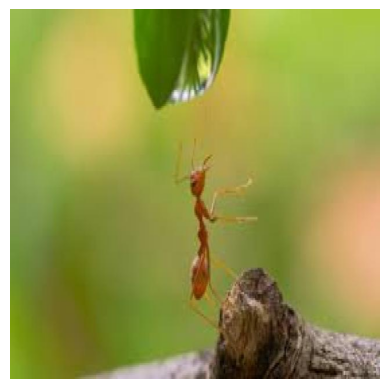

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



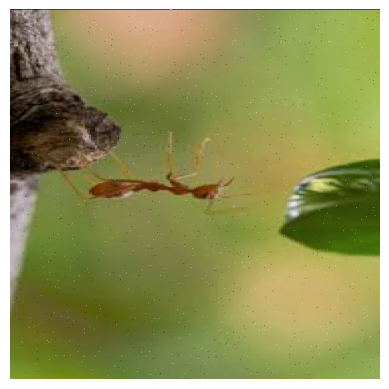

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



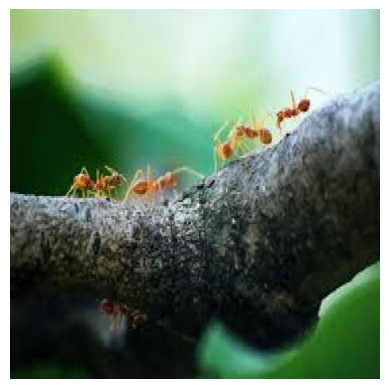

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



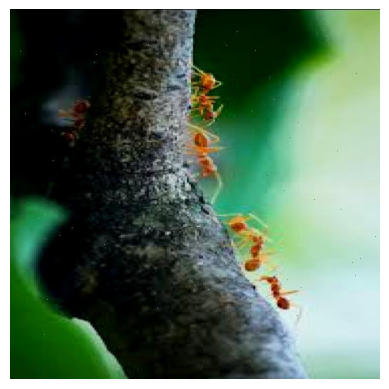

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



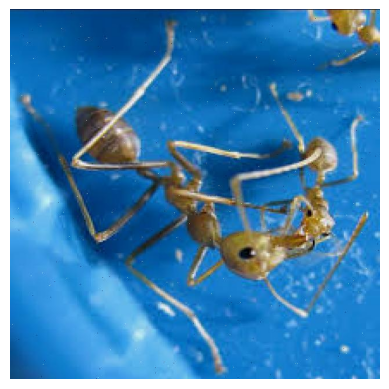

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



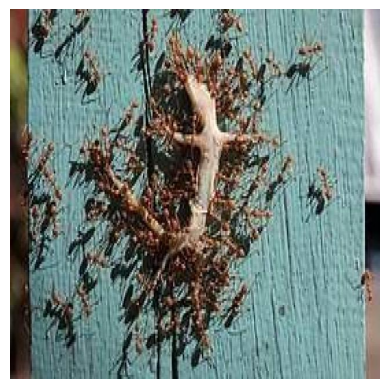

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



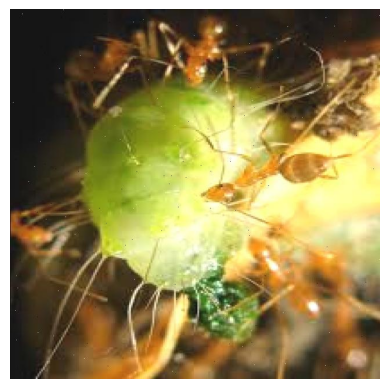

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



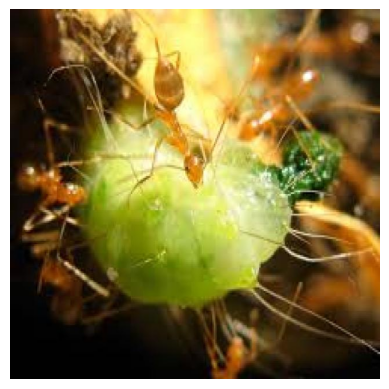

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



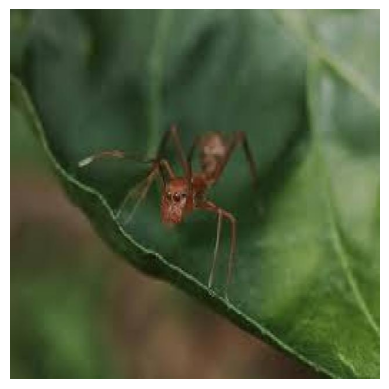

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



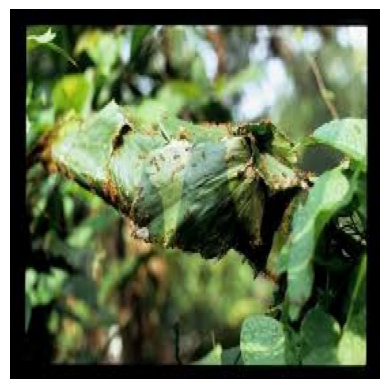

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



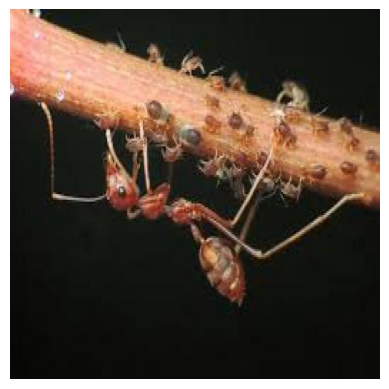

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



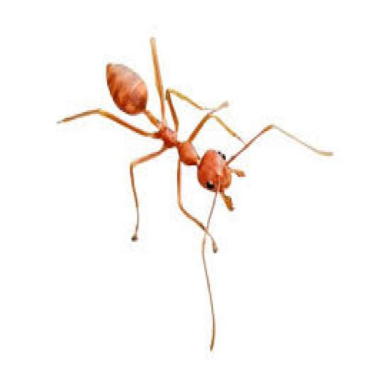

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



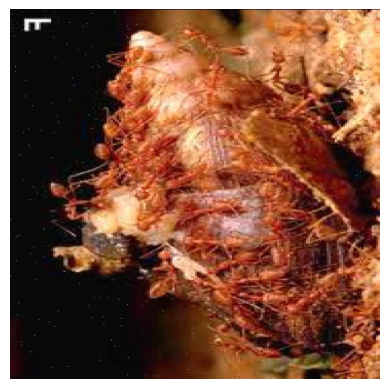

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



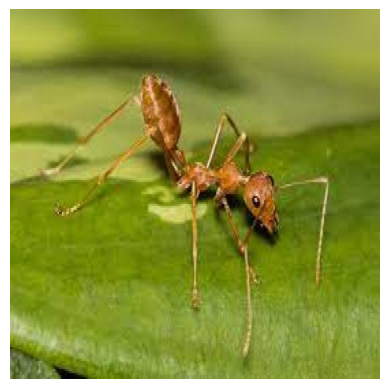

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



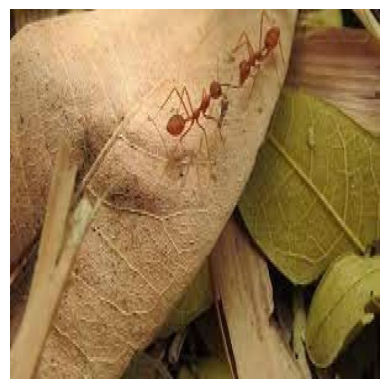

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



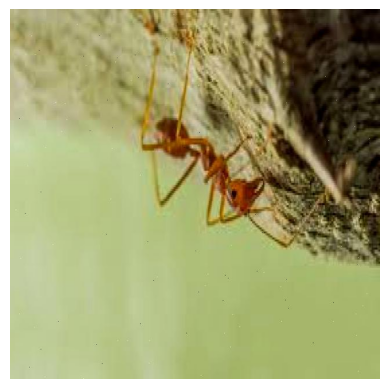

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



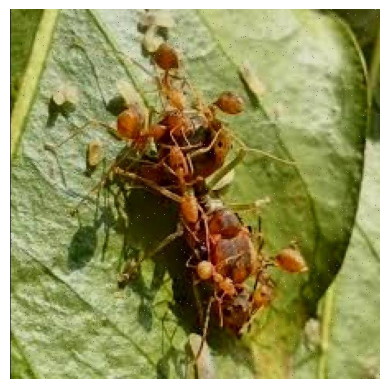

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



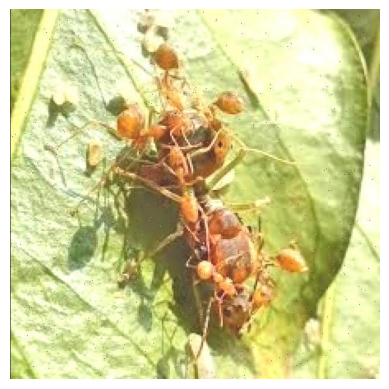

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



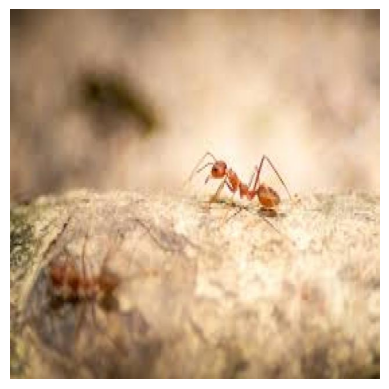

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



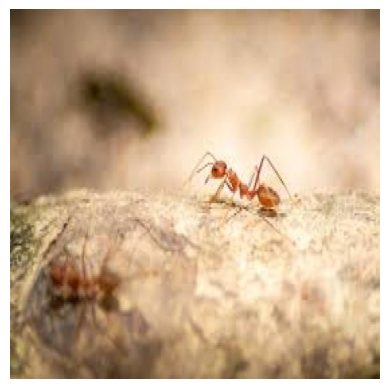

Recommendation: Fire Ant: Handle with caution. Can sting and cause irritation. Use insecticide specifically formulated for fire ants.



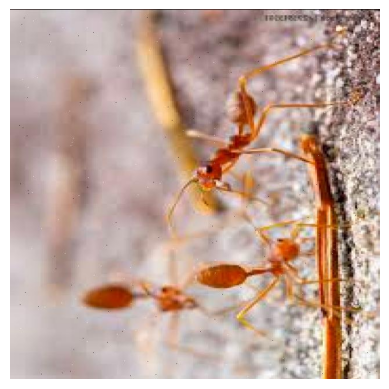

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



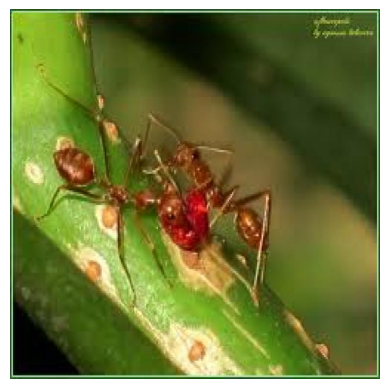

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



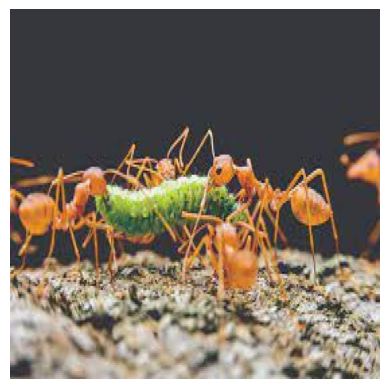

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



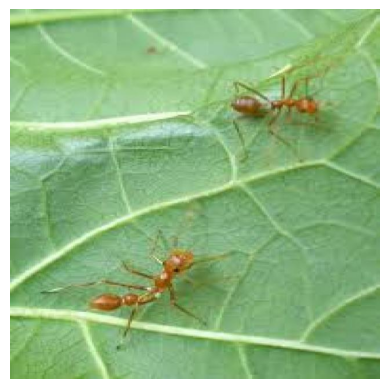

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



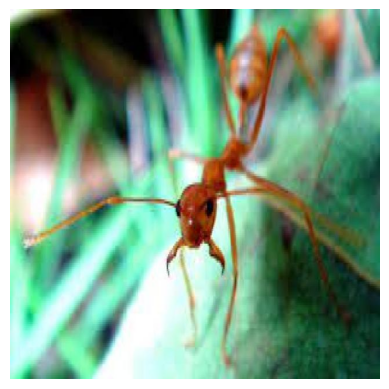

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



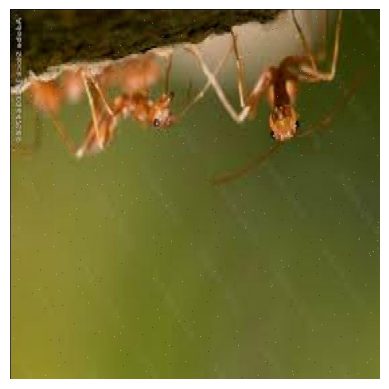

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



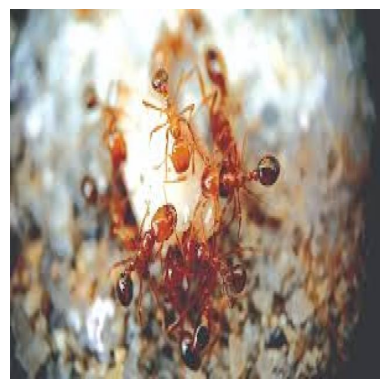

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



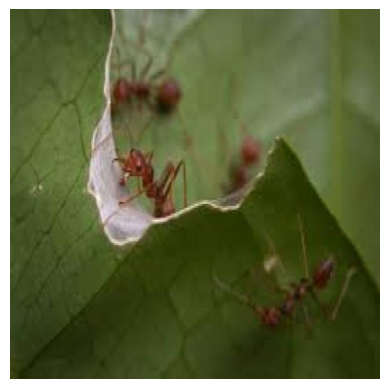

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



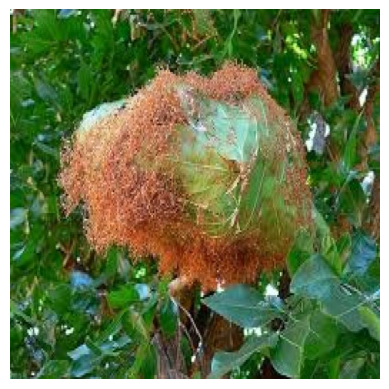

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



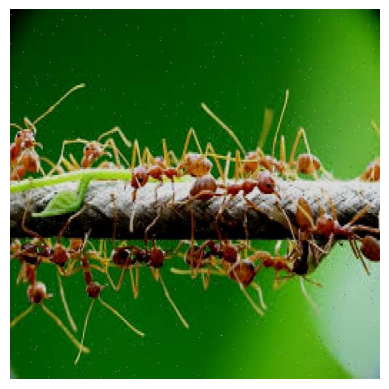

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



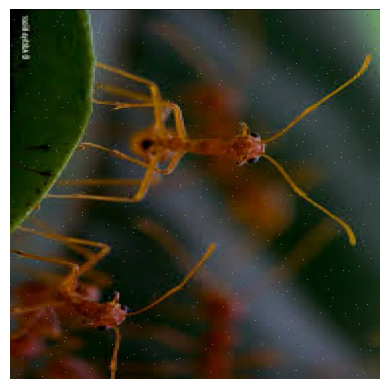

Recommendation: Weaver Ant: Can be beneficial for pest control in gardens. Avoid disturbing nests. Trim tree branches to reduce access points and use insecticidal soap to control weaver ants.



In [12]:
# Predict and provide recommendations for all test images
test_predictions = mobilenet_model.predict(test_generator)
for i, (image, prediction) in enumerate(zip(test_generator.filenames, test_predictions)):
    predicted_class = np.argmax(prediction)
    
    # Load and display the image
    img = plt.imread(os.path.join(test_dir, image))
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    
    # Print recommendation
    print("Recommendation:", recommendations[predicted_class])
    print()

In [13]:
mobilenet_model.save(R'C:\Users\jroqu\OneDrive\Desktop\CPE313\Final Project\Ant Species Classification.v1i.multiclass\Webapp\models\mobilenet_model.h5')